In [1]:
from PIL import Image
from pathlib import Path
import os
from os.path import join

stim_folder = "/Users/binxuwang/Library/CloudStorage/OneDrive-HarvardUniversity/VVS_Accentuation_project/stimuli_pilot_20241119/results"

In [2]:
from circuit_toolkit.plot_utils import saveallforms, showimg, show_imgrid

/Users/binxuwang/Github/circuit_toolkit/circuit_toolkit/GAN_invert_utils.py:2: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import trange, tqdm


In [3]:
!ls {stim_folder}

clip_neg_0_2048_im.png      r50_neg_0_2048_im.png
clip_neg_0_2048_tr.png      r50_neg_0_2048_tr.png
clip_neg_0_512_im.png       r50_neg_0_512_im.png
clip_neg_0_512_tr.png       r50_neg_0_512_tr.png
clip_neg_1_2048_im.png      r50_neg_1_2048_im.png
clip_neg_1_2048_tr.png      r50_neg_1_2048_tr.png
clip_neg_1_512_im.png       r50_neg_1_512_im.png
clip_neg_1_512_tr.png       r50_neg_1_512_tr.png
clip_neg_2_2048_im.png      r50_neg_2_2048_im.png
clip_neg_2_2048_tr.png      r50_neg_2_2048_tr.png
clip_neg_2_512_im.png       r50_neg_2_512_im.png
clip_neg_2_512_tr.png       r50_neg_2_512_tr.png
clip_neg_3_2048_im.png      r50_neg_3_2048_im.png
clip_neg_3_2048_tr.png      r50_neg_3_2048_tr.png
clip_neg_3_512_im.png       r50_neg_3_512_im.png
clip_neg_3_512_tr.png       r50_neg_3_512_tr.png
clip_neg_4_2048_im.png      r50_neg_4_2048_im.png
clip_neg_4_2048_tr.png      r50_neg_4_2048_tr.png
clip_neg_4_512_im.png       r50_neg_4_512_im.png
clip_neg_4_512_tr.png       r50_neg_4_512_tr.png
clip_neg_5

In [4]:
from PIL import Image

def create_image_grid(image_paths, grid_size, image_size=None, padding=0, bg_color=(255, 255, 255)):
    """
    Assembles multiple images into a grid and saves the result.

    Parameters:
    - image_paths: List of file paths to the images.
    - grid_size: Tuple (columns, rows) specifying the grid dimensions.
    - output_path: File path to save the resulting grid image.
    - image_size: Tuple (width, height) specifying the size to which each image should be resized. If None, original sizes are used.
    - padding: Integer specifying the number of pixels between images.
    - bg_color: Tuple specifying the RGB color for the background.
    """
    if isinstance(image_paths, str):
        image_paths = [image_paths]
    elif isinstance(image_paths, list):
        if isinstance(image_paths[0], str):
            images = [Image.open(path) for path in image_paths]
        else:
            images = image_paths
    else:
        raise ValueError("image_paths must be a list of file paths or a single file path")

    # Resize images if image_size is specified
    if image_size:
        images = [img.resize(image_size, Image.Resampling.LANCZOS) for img in images]
        image_width, image_height = image_size
    else:
        # Use the size of the first image
        image_width, image_height = images[0].size

    grid_columns, grid_rows = grid_size

    # Calculate grid dimensions including padding
    grid_width = grid_columns * image_width + (grid_columns - 1) * padding
    grid_height = grid_rows * image_height + (grid_rows - 1) * padding

    # Create a new blank image with the specified background color
    grid_image = Image.new('RGB', (grid_width, grid_height), color=bg_color)

    # Paste images into the grid
    for index, image in enumerate(images):
        row = index // grid_columns
        col = index % grid_columns
        x_offset = col * (image_width + padding)
        y_offset = row * (image_height + padding)
        grid_image.paste(image, (x_offset, y_offset))
    return grid_image
    # Save the resulting grid image
    grid_image.save(output_path)
    print(f"Image grid saved to {output_path}")

Unit 0
Unit 1
Unit 2
Unit 3
Unit 4
Unit 5
Unit 6
Unit 7


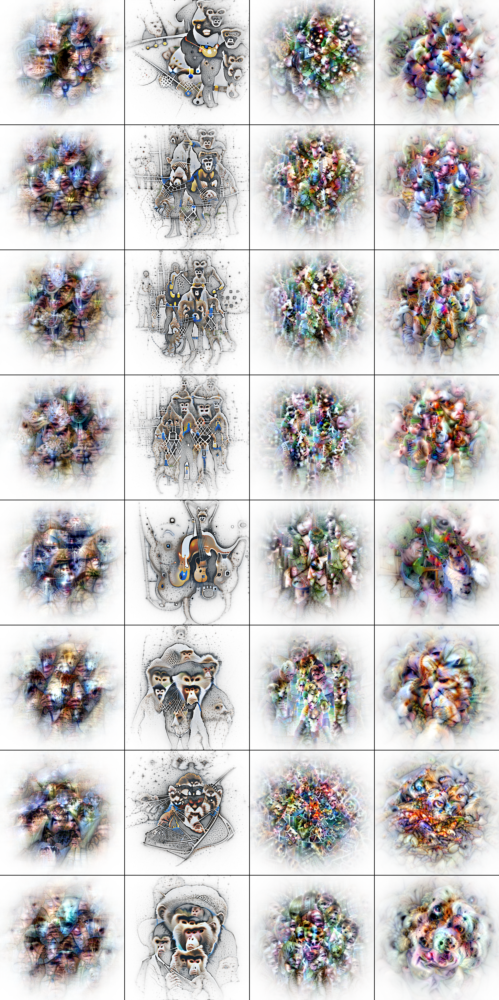

In [7]:
model_names = ["r50", "robustr50", "dinov1", "clip"]
directions = ["pos", "neg"]
direction = directions[0]
img_col = []
for unit_id in range(0, 8):
    print(f"Unit {unit_id}")
    for model_name in model_names:
        img = Image.open(join(stim_folder, f"{model_name}_{direction}_{unit_id}_512_tr.png"))
        img_col.append(img)

create_image_grid(img_col, (4, 8), image_size=(384, 384), padding=2, bg_color=(0, 0, 0))

Unit 0
Unit 1
Unit 2
Unit 3
Unit 4
Unit 5
Unit 6
Unit 7


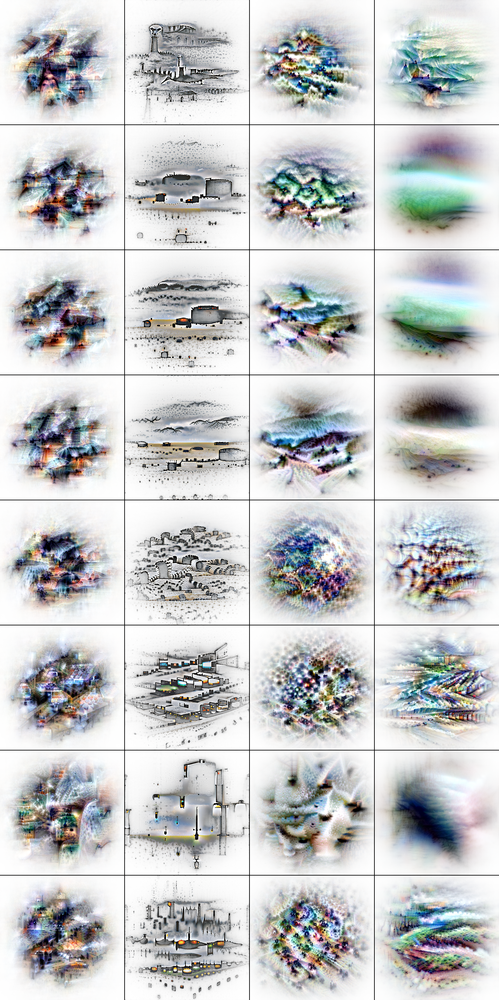

In [6]:
model_names = ["r50", "robustr50", "dinov1", "clip"]
directions = ["pos", "neg"]
direction = directions[1]
img_col = []
for unit_id in range(0, 8):
    print(f"Unit {unit_id}")
    for model_name in model_names:
        img = Image.open(join(stim_folder, f"{model_name}_{direction}_{unit_id}_512_tr.png"))
        img_col.append(img)

create_image_grid(img_col, (4, 8), image_size=(384, 384), padding=2, bg_color=(0, 0, 0))